The [Pandas DataFrame](http://pandas.pydata.org/) we use within OENotebook makes it very easy to calculate correlations for molecule data. In this example we'll load some molecules, generate and store some associated data for each molecule, and then explore some built-in functions to calculate and visualize correlations in this data.

In [2]:
from __future__ import print_function, division

%matplotlib inline

from matplotlib import pyplot as plt
import seaborn as sns

sns.set_context("poster")

import numpy as np

In [3]:
import oenotebook as oenb

from openeye.oechem import OECalculateMolecularWeight
from openeye.oemolprop import OEGetXLogP, OEGet2dPSA


,Molecule,MW,XlogP,2D_PSA
0,,225.244400,-0.809,84.220001
1,,305.276126,2.339,38.769997
2,,324.333940,0.147,100.290001

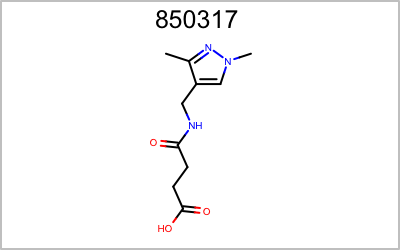
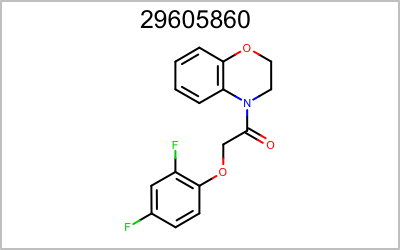
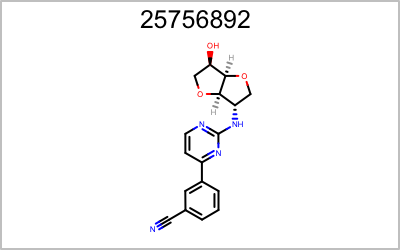

In [4]:
df = oenb.read_file_to_dataframe("./eMol_ran1k.ism")

df["MW"] = df.Molecule.apply(OECalculateMolecularWeight)
df["XlogP"] = df.Molecule.apply(OEGetXLogP)
df["2D_PSA"] = df.Molecule.apply(OEGet2dPSA)

oenb.render_dataframe(df.head(3))

### Calculating Correlations
Now that we have some molecules and data, we'll use some of the build in functions of the dataframe to calculate correlations.

In [9]:
corr = df[["MW","XlogP","2D_PSA"]].corr()
corr

,MW,XlogP,2D_PSA
MW,1.000000,0.478629,0.434144
XlogP,0.478629,1.000000,-0.307729
2D_PSA,0.434144,-0.307729,1.000000


While the default above is a [Pearson](https://en.wikipedia.org/wiki/Spearman%27s_rank_correlation_coefficient) correlation, we can ask for others such as a [Spearman rank](https://en.wikipedia.org/wiki/Spearman%27s_rank_correlation_coefficient) correlation.

In [11]:
df[["MW","XlogP","2D_PSA"]].corr(method="spearman")

,MW,XlogP,2D_PSA
MW,1.000000,0.452671,0.398284
XlogP,0.452671,1.000000,-0.296007
2D_PSA,0.398284,-0.296007,1.000000


### Visualizing the Correlation
There are many ways to visualize these correlations. Below we'll plot the correlation matrix directly using the [heatmap functionality of Seaborn](https://stanford.edu/~mwaskom/software/seaborn/generated/seaborn.heatmap.html), and then use some advanced functionality in [Seaborn](https://stanford.edu/~mwaskom/software/seaborn/tutorial/regression.html#functions-to-draw-linear-regression-models) and [OENotebook](http://beta-docs.eyesopen.com/toolkits/oenotebook/#oenotebook.add_molecule_tooltips) to look at the anti-correlation between Molecular Weight and 2D polar surface area.

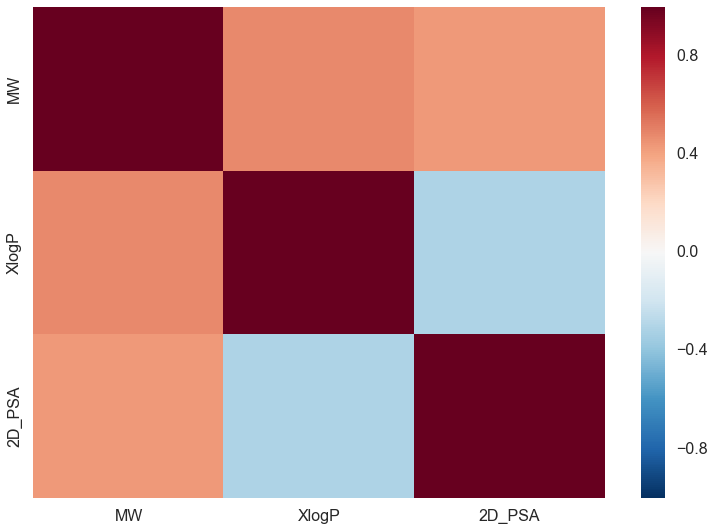

In [12]:
sns.heatmap(corr);


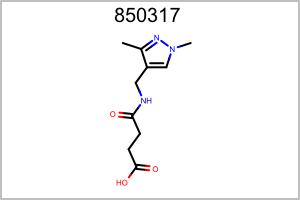
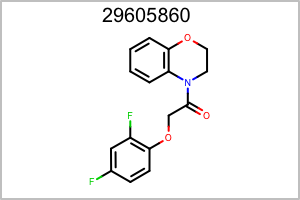
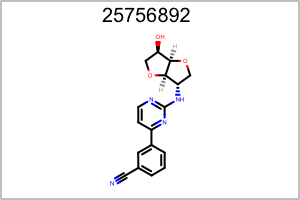
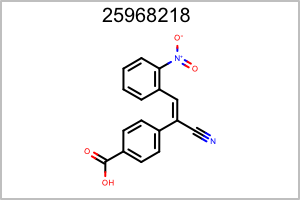
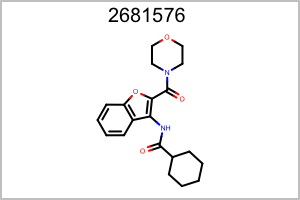
...
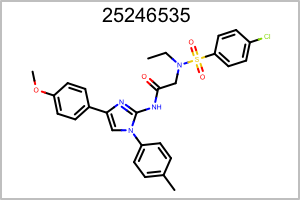
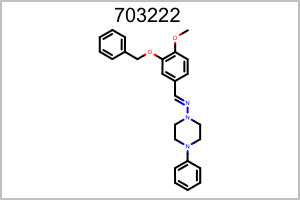
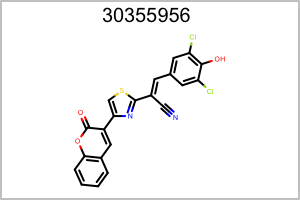
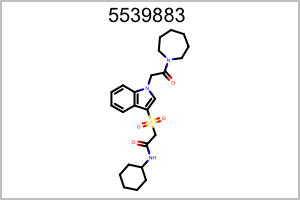
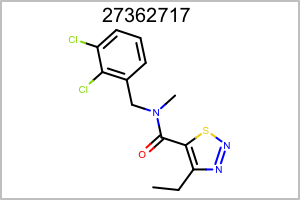

In [9]:
ax = sns.regplot(x="XlogP",y="2D_PSA",data=df,scatter_kws={"s":150, "alpha":0.5})
sc = ax.collections[0]
sc.set_zorder(2)
oenb.add_molecule_tooltips(df.Molecule,sc,plt.gcf())